In [1]:
import importlib
import pandas as pd
import os
import sys
import pwd
import numpy as np
from pathlib import Path
from tqdm import tqdm, trange
from tqdm.contrib.concurrent import process_map
from meth import tools as mtools
import matplotlib.pyplot as plt
import GEOparse
import scanpy as sc
from scipy import sparse as sp
import scipy as spy
from scipy.stats import linregress, entropy
from meth import analytic_tools as anatools
plt.style.use('../Stochastic aging/pics/meth.mplstyle')

In [2]:
cwd = Path.cwd()
dsets = {}
binned_by = 1
paths = {'Mice': Path.joinpath(cwd, Path(f'data/GSE80672/GSE80672_coverage_0_binned_by_1_wmeta_only_percent.h5ad'))
        }

for key in paths.keys():
    dsets[key] = sc.read_h5ad(paths[key])

In [8]:
dsets['Mice'].var['Age'] = dsets['Mice'].var['Age'] / 12.

In [9]:
for key in paths.keys():
    print("Dataset {}, loaded from {}".format(key, paths[key]))
    print(dsets[key], '\n')

Dataset Mice, loaded from /Users/tarkhov/Dropbox/Harvard/Science/Stochastic aging/data/GSE80672/GSE80672_coverage_0_binned_by_1_wmeta_only_percent.h5ad
AnnData object with n_obs × n_vars = 1976056 × 255
    var: 'Sample Name', 'Strain/Condition', 'Age', 'Sex', 'Prepared for Sequencing ', 'Used in Subset 1/2', 'Data Type' 



In [10]:
dsets[key].X /= 100.

In [15]:
colors_rough = ['g', 'y', 'r']
labels_rough = ["Young", "Middle", "Old"]

In [16]:
importlib.reload(anatools)
key = 'Mice'

if key == 'Mice':
    key = 'Mice_C57BL6'
    idx_to_choose = dsets['Mice'].var['Strain/Condition'].values == 'C57BL/6'
    dsets[key] = sc.AnnData(dsets['Mice'].X[:,idx_to_choose], var=dsets['Mice'].var.iloc[idx_to_choose], obs=dsets['Mice'].obs)
    key = 'Mice_CR'
    idx_to_choose = dsets['Mice'].var['Strain/Condition'].values == 'C57BL/6 (Calorie Restricted)'
    dsets[key] = sc.AnnData(dsets['Mice'].X[:,idx_to_choose], var=dsets['Mice'].var[idx_to_choose], obs=dsets['Mice'].obs)
key = 'Mice_C57BL6'

X = dsets[key].X
print(np.sum(np.isnan(X)))
X = anatools.mask_0_1_tonan(X)
print(np.sum(np.isnan(X)))

16111951
118895090


In [17]:
if key == 'Mice_CR':
    N_age_bins = 3
elif key == 'NMR':
    N_age_bins = 4
else:
    N_age_bins = 7

dsets[key].var['Age_bin'] = pd.cut(dsets[key].var['Age'], 
                                   [np.min(dsets[key].var['Age'].values) -  2e-3 + i * (np.max(dsets[key].var['Age'].values) + 4e-3 - np.min(dsets[key].var['Age'].values)) / N_age_bins
                                    for i in range(N_age_bins + 1)], include_lowest=True)
dsets[key].var['Age_bin_rough'] = pd.cut(dsets[key].var['Age'], 
                                   [np.min(dsets[key].var['Age'].values) -  2e-3 + i * (np.max(dsets[key].var['Age'].values) + 4e-3 - np.min(dsets[key].var['Age'].values)) / 3
                                    for i in range(3 + 1)], include_lowest=True)
print(dsets[key].var['Age_bin'].value_counts())

(0.629, 1.011]    28
(2.155, 2.537]    28
(0.247, 0.629]    27
(2.537, 2.918]    22
(1.774, 2.155]    18
(1.011, 1.392]     9
(1.392, 1.774]     9
Name: Age_bin, dtype: int64


In [18]:
print(dsets[key].var['Age_bin_rough'].value_counts())

(0.247, 1.138]    55
(2.028, 2.918]    50
(1.138, 2.028]    36
Name: Age_bin_rough, dtype: int64


In [19]:
if key == 'NMR':
    N_nonan = 3
elif key == 'Mice_CR':
    N_nonan = 3
else:
    N_nonan = 6
# N_nonan = 4
idx_filter = np.zeros(X.shape[0])
for age_bin in dsets[key].var['Age_bin'].unique():
    jdx = dsets[key].var['Age_bin'] == age_bin
    idx_tmp = np.sum(~np.isnan(X[:,jdx]), axis=1) >= N_nonan
    idx_filter += 1. * idx_tmp

In [21]:
dsets[key].obs['mask_nonzero'] = idx_filter == N_age_bins
X = X[idx_filter == N_age_bins, :]

In [24]:
X = X.astype(np.float64)
Y = np.log(X / (1. - X))
age = dsets[key].var['Age'].values
r, p = anatools.fast_pearsonr(Y, age)

In [25]:
dsets[key].obs['r_age'] = 0.
dsets[key].obs['p_age'] = 1.
dsets[key].obs['r_age'][dsets[key].obs['mask_nonzero']] = r
dsets[key].obs['p_age'][dsets[key].obs['mask_nonzero']] = p

/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_56428/1546667402.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dsets[key].obs['r_age'][dsets[key].obs['mask_nonzero']] = r
/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_56428/1546667402.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dsets[key].obs['p_age'][dsets[key].obs['mask_nonzero']] = p


In [26]:
(dsets[key].obs['p_age'] < 0.05).sum() / dsets[key].obs['p_age'].shape[0]

0.13564595335354868

In [27]:
(dsets[key].obs['p_age'] < 0.05 / dsets[key].obs['p_age'].shape[0]).sum() / dsets[key].obs['p_age'].shape[0]

0.008546822559684543

In [32]:
key = 'Mice_C57BL6'
dsets[key].var['Age_bin_rough'].value_counts().keys()# * 12.
abins = np.array([0.247, 1.138, 2.028, 2.918])
print(abins * 12)

[ 2.964 13.656 24.336 35.016]


In [33]:
# labels_rough_2
labels_rough_2 = ['3-14 m', '14-24 m', '24-35 m']

In [34]:
dsets['Mice_C57BL6'].obs

,mask_nonzero,r_age,p_age
index,,,
chr10_100015516,True,0.247693,0.004339
chr10_100015517,False,0.000000,1.000000
chr10_100015540,True,0.372971,0.000155
chr10_100015541,False,0.000000,1.000000
chr10_100015553,True,0.202238,0.019109
...,...,...,...
chrY_998589,True,-0.329420,0.000102
chrY_998593,True,0.047016,0.586763
chrY_998594,True,-0.182137,0.034492


In [35]:
print(np.sum(idx_filter == N_age_bins))
print(idx_filter.shape)

df_cpgs = dsets[key].obs.iloc[idx_filter == N_age_bins,:]
df_cpgs.head()

810203
(1976056,)


,mask_nonzero,r_age,p_age
index,,,
chr10_100015516,True,0.247693,0.004339
chr10_100015540,True,0.372971,0.000155
chr10_100015553,True,0.202238,0.019109
chr10_100015554,True,0.033357,0.709672
chr10_100015601,True,0.016966,0.852851


In [36]:
iunsort = np.nonzero(np.logical_and(df_cpgs['r_age'].abs().values < 0.01, df_cpgs['p_age'].values > 0.95))[0]
iunsort = iunsort[2::3000]

In [37]:
cologs_rough_2 = ['#fc8d59',
                  '#ffffbf',
                  '#91bfdb']
cologs_rough_2 = ['#fc8d59',
'#ffffbf',
'#91cf60'][::-1]

# Fig. 1d

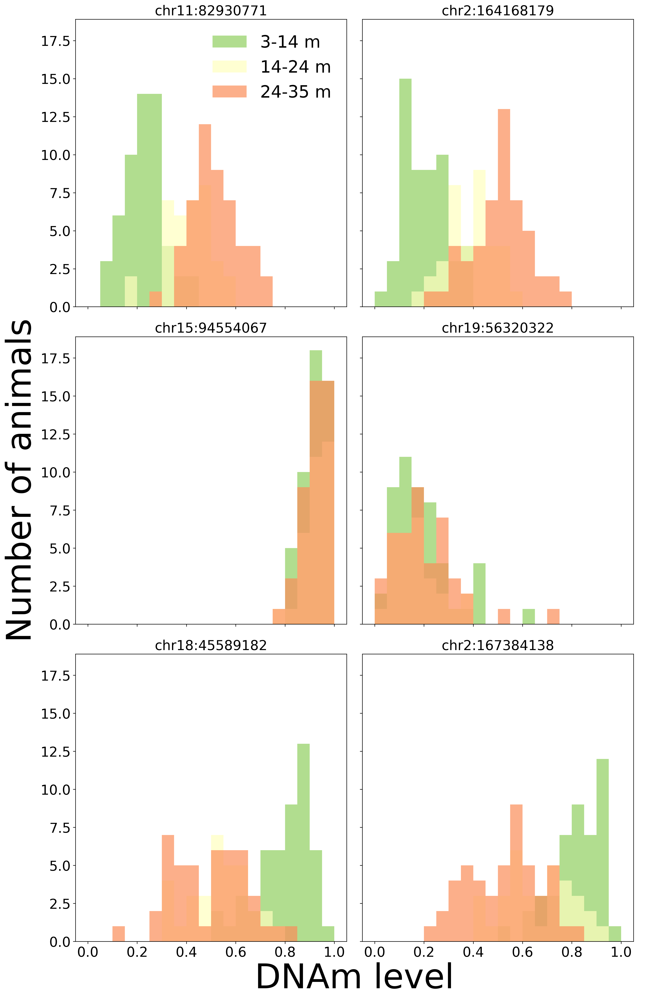

In [38]:
from scipy.stats import entropy

N_pl_row = 3
N_pl_row_x = 2
fig, ax = plt.subplots(N_pl_row, N_pl_row_x, figsize=(N_pl_row_x * 7,N_pl_row * 7), sharex=True, sharey=True, dpi=300)
fig.add_subplot(111, frameon=False)
i = 0

isorted_by_r = np.argsort(r[isign])[::-1]
isort = isign[isorted_by_r][::2]
isort_rev = isign[isorted_by_r][::-1][::2]

for j1 in np.arange(N_pl_row):#isort[:25]:
    for j2 in np.arange(N_pl_row_x):#isort[:25]:
        if j1 == 0:
            j = isort[j1 * N_pl_row_x + j2]
        elif j1 == 1:
            j = iunsort[j1 * N_pl_row_x + j2]
        elif j1 == 2:
            j = isort_rev[j1 * N_pl_row_x + j2]
        i = 0
        for age_bin, df in dsets[key].var.groupby('Age_bin_rough'):
            idx = np.nonzero(dsets[key].var['Age_bin_rough'].values == age_bin)[0]
            ax[j1,j2].hist(X[j,idx], alpha=0.7, color=cologs_rough_2[i],
                           bins=20, density=False, range=(0,1), 
                           label=labels_rough_2[i])
            i += 1
            
            ax[j1,j2].set_title(df_cpgs.index[j].replace('_',':'))
ax[N_pl_row-1,N_pl_row_x//2].set_xlabel("")
ax[0,0].legend(fontsize=25, loc='upper right', frameon=False)
ax[1,0].set_ylabel('Number of animals', fontsize=50)
plt.tick_params(labelcolor='none', which='both', top=False, bottom=False, left=False, right=False)
plt.xlabel("DNAm level", fontsize=50)
plt.tight_layout()
plt.savefig("pics/jpg/meth_age_dep_topR_poster_{}.jpg".format(key), format="jpg", dpi=300)
plt.savefig("pics/pdf/meth_age_dep_topR_poster_{}.pdf".format(key), format="pdf", dpi=300)
plt.savefig("pics/png/meth_age_dep_topR_poster_{}.png".format(key), format="png", dpi=300)
plt.show()

In [40]:
indices = isign
print(len(indices))

19685


In [41]:
def theory_dist(x, ksi, sigma):
    return 1./np.sqrt(2. * np.pi * (sigma ** 2) * x * (1. - x)) * np.exp(- 1./(2 * (sigma ** 2)) * np.power(np.log(x/(1-x)) - ksi, 2))

In [43]:
X = X.astype(np.float64)
Y = Y.astype(np.float64)

In [44]:
strains = dsets[key].var['Strain/Condition'].value_counts()[dsets[key].var['Strain/Condition'].value_counts() > 9].index

In [45]:
strains

CategoricalIndex(['C57BL/6'], categories=['B6D2F1', 'B6D2F1(Calorie Restricted)', 'C57BL/6', 'C57BL/6 (Calorie Restricted)', 'C57BL/6_NIA/BWH', 'Derived from K1', 'Derived from K2', 'Derived from K3', ...], ordered=False, dtype='category')

In [46]:
fit_stats_by_strain = {'ksi': np.zeros((X.shape[0],strains.shape[0], N_age_bins)),
             'sigma': np.zeros((X.shape[0],strains.shape[0], N_age_bins)),
             'ksi_X': np.zeros((X.shape[0],strains.shape[0], N_age_bins)),
             'sigma_X': np.zeros((X.shape[0],strains.shape[0], N_age_bins)),
             'age_bins': np.sort(dsets[key].var['Age_bin'].unique()),
             'age_bins_mid': np.array([x.mid for x in np.sort(dsets[key].var['Age_bin'].unique())])
            }
for j, strain in enumerate(strains):
    jdx = dsets[key].var['Strain/Condition'].values == strain
    for i, age_bin in enumerate(fit_stats_by_strain['age_bins']):
        print(age_bin)
        idx = dsets[key].var['Age_bin'].values == age_bin
        idx = np.nonzero(np.logical_and(idx, jdx))[0]
        fit_stats_by_strain['ksi'][:,j, i] = np.nanmean(Y[:,idx], axis=1)
        fit_stats_by_strain['sigma'][:,j, i] = np.nanstd(Y[:,idx], axis=1)
        fit_stats_by_strain['ksi_X'][:,j, i] = np.nanmean(X[:,idx], axis=1)
        fit_stats_by_strain['sigma_X'][:,j, i] = np.nanstd(X[:,idx], axis=1)

(0.247, 0.629]
(0.629, 1.011]
(1.011, 1.392]
(1.392, 1.774]
(1.774, 2.155]
(2.155, 2.537]
(2.537, 2.918]


In [47]:
fit_stats = {'ksi': np.zeros((X.shape[0],N_age_bins)),
             'sigma': np.zeros((X.shape[0],N_age_bins)),
             'ksi_X': np.zeros((X.shape[0],N_age_bins)),
             'sigma_X': np.zeros((X.shape[0],N_age_bins)),
             'age_bins': np.sort(dsets[key].var['Age_bin'].unique()),
             'age_bins_mid': np.array([x.mid for x in np.sort(dsets[key].var['Age_bin'].unique())])
            }

for i, age_bin in enumerate(fit_stats['age_bins']):
    print(age_bin)
    idx = np.nonzero(dsets[key].var['Age_bin'].values == age_bin)[0]
    fit_stats['ksi'][:,i] = np.nanmean(Y[:,idx], axis=1)
    fit_stats['sigma'][:,i] = np.nanstd(Y[:,idx], axis=1)
    fit_stats['ksi_X'][:,i] = np.nanmean(X[:,idx], axis=1)
    fit_stats['sigma_X'][:,i] = np.nanstd(X[:,idx], axis=1)

(0.247, 0.629]
(0.629, 1.011]
(1.011, 1.392]
(1.392, 1.774]
(1.774, 2.155]
(2.155, 2.537]
(2.537, 2.918]


In [48]:
idx_bioages = {
               'entropic_BA': np.hstack((np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] > 0)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  isign)
                                                 ),
                                        np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] < 0)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  isign)
                                                 ))
                                       ),

               'entropic_down_BA': np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] > 0)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  isign)
                                                 ),
               'entropic_up_BA': np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] < 0)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  isign)
                                                 ),
               'antientropic_down_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  isign)
                                                 ),
               'antientropic_up_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  isign)
                                                 ),
               'antientropic_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                  isign
                                                 ),
               'constant_BA': np.nonzero(p > 0.05)[0],
               
               'insignificant_BA': np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0],

               'antient_insignificant_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                          np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0]
                                                         ),
               
               'antient_insignificant_up_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0]),
                                                 ),
    
               'antient_insignificant_down_BA': np.intersect1d(np.nonzero(np.abs(fit_stats['ksi'][:, 0]) < 1.25)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0])
                                                 ),
    
               'ent_insignificant_up_BA': np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] < 0)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0]),
                                                 ),
    
               'ent_insignificant_down_BA': np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] > 0)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0])
                                                 ),
               'ent_insignificant_BA': np.hstack((np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] > 0)[0],
                                                  np.intersect1d(np.nonzero(r <= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0])
                                                 ),
                                        np.intersect1d(np.nonzero(fit_stats['ksi'][:, 0] < 0)[0],
                                                  np.intersect1d(np.nonzero(r >= 0)[0],
                                                  np.nonzero(np.logical_and(p > 0.05 / X.shape[0], p < 0.05))[0])
                                                 ))
                                       ),
    
                                     }
idx_glob_bioages = {}
for bioage in idx_bioages.keys():
    idx_glob_bioages[bioage] = dsets[key].obs.index[np.nonzero(dsets[key].obs['mask_nonzero'].values)[0]][idx_bioages[bioage]]

In [49]:
bioages = idx_bioages.keys()
importlib.reload(anatools)
b, x0 = anatools.shooting(fit_stats['ksi'], fit_stats['age_bins_mid'])
print(b.shape, x0.shape)

(810203,) (810203,)


In [50]:
print(fit_stats['ksi'].shape, r.shape, bioages, b.shape)

# bioages = ['entropic_BA','entropic_down_BA', 'entropic_up_BA','antientropic_BA','antientropic_down_BA','antientropic_up_BA', 'constant_BA', 'insignificant_BA', 'insignificant_down_BA', 'insignificant_up_BA']
for bioage in bioages:
    dsets[key].obs[["{}_b".format(bioage), "{}_x0".format(bioage)]] = 0.
    dsets[key].var[bioage] = 0.

(810203, 7) (810203,) dict_keys(['entropic_BA', 'entropic_down_BA', 'entropic_up_BA', 'antientropic_down_BA', 'antientropic_up_BA', 'antientropic_BA', 'constant_BA', 'insignificant_BA', 'antient_insignificant_BA', 'antient_insignificant_up_BA', 'antient_insignificant_down_BA', 'ent_insignificant_up_BA', 'ent_insignificant_down_BA', 'ent_insignificant_BA']) (810203,)


In [51]:
for bioage in bioages:
    dsets[key].obs.loc[idx_glob_bioages[bioage],'{}_b'.format(bioage)] = b[idx_bioages[bioage]]
    dsets[key].obs.loc[idx_glob_bioages[bioage],'{}_x0'.format(bioage)] = x0[idx_bioages[bioage]]

In [52]:
for bioage in bioages:
    b_loc = dsets[key].obs["{}_b".format(bioage)][dsets[key].obs['mask_nonzero']].values.reshape(-1,1)
    x0_loc = dsets[key].obs["{}_x0".format(bioage)][dsets[key].obs['mask_nonzero']].values.reshape(-1,1)
    
    b_loc[np.abs(b_loc) > 1e-9] = 1./b_loc[np.abs(b_loc) >1e-9]
    dsets[key].var[bioage] = np.dot(np.nan_to_num((Y-x0_loc)).T,b_loc)
    
#     dsets[key].var[bioage] = np.dot(np.nan_to_num((Y+x0_loc)).T,b_loc)

In [53]:
# key_full = 'Mice'
# key_full = 'Mice_embryos'
for key_full in ['Mice']:# 'Mice_embryos','Mice_para_blood', 'Mice_para_liver']:
    for bioage in bioages:
        dsets[key_full].obs[["{}_b".format(bioage), "{}_x0".format(bioage)]] = 0.
        dsets[key_full].var[bioage] = 0.

In [54]:
key = 'Mice_C57BL6'
key_full = 'Mice'
Y_tmp = anatools.logit(anatools.mask_0_1_tonan(dsets[key_full].X.astype(np.float64)))
for bioage in bioages:
    b_loc = dsets[key].obs["{}_b".format(bioage)].values.reshape(-1,1)
    x0_loc = dsets[key].obs["{}_x0".format(bioage)].values.reshape(-1,1)
    idx = np.abs(b_loc) > 1e-9
    idx = idx.flatten()
    b_loc[idx] = 1./b_loc[idx]
    print(Y_tmp.shape, idx.shape)
    rescale_for_nans = 1. * np.sum(~np.isnan(Y_tmp)[idx,:], axis=0)
    dsets[key_full].var[bioage] = np.dot(np.nan_to_num((Y_tmp-x0_loc)).T,b_loc) / rescale_for_nans
    
#     dsets[key].var[bioage] = np.dot(np.nan_to_num((Y+x0_loc)).T,b_loc)

(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)


In [55]:
dsets[key_full].obs.index

Index(['chr10_100015516', 'chr10_100015517', 'chr10_100015540',
       'chr10_100015541', 'chr10_100015553', 'chr10_100015554',
       'chr10_100015601', 'chr10_100015602', 'chr10_100015640',
       'chr10_100015641',
       ...
       'chrY_998550', 'chrY_998551', 'chrY_998568', 'chrY_998569',
       'chrY_998588', 'chrY_998589', 'chrY_998593', 'chrY_998594',
       'chrY_998603', 'chrY_998604'],
      dtype='object', name='index', length=1976056)

In [56]:
common_indices, idx_full, idx_key = np.intersect1d(dsets[key_full].obs.index.values, dsets[key].obs.index.values, return_indices=True)


In [57]:
# idx_full, idx_key
dsets.keys()

dict_keys(['Mice', 'Mice_C57BL6', 'Mice_CR'])

In [58]:
key_full = 'Mice_C57BL6'
# key = 'Mice_embryos'
for key in ['Mice']:#,'Mice_embryos', 'Mice_para_blood', 'Mice_para_liver']:
    common_indices, idx_full, idx_key = np.intersect1d(dsets[key_full].obs.index.values, dsets[key].obs.index.values, return_indices=True)
    print(common_indices.shape)
    Y_tmp = anatools.logit(anatools.mask_0_1_tonan(dsets[key].X[idx_key,:].astype(np.float64)))
    for bioage in bioages:
        b_loc = dsets[key_full].obs.loc[common_indices,"{}_b".format(bioage)].values.reshape(-1,1)
        x0_loc = dsets[key_full].obs.loc[common_indices,"{}_x0".format(bioage)].values.reshape(-1,1)
        idx = np.abs(b_loc) > 1e-9
        idx = idx.flatten()
        b_loc[idx] = 1./b_loc[idx]
        print(Y_tmp.shape, idx.shape)
        rescale_for_nans = 1. * np.sum(~np.isnan(Y_tmp)[idx,:], axis=0)
        dsets[key].var[bioage] = np.dot(np.nan_to_num((Y_tmp-x0_loc)).T,b_loc) / rescale_for_nans
        dsets[key].obs["{}_b".format(bioage)] = np.nan
        dsets[key].obs["{}_x0".format(bioage)] = np.nan

        dsets[key].obs.loc[common_indices, "{}_b".format(bioage)] = b_loc
        dsets[key].obs.loc[common_indices, "{}_x0".format(bioage)] = x0_loc
        
#     dsets[key].var[bioage] = np.dot(np.nan_to_num((Y+x0_loc)).T,b_loc)

(1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)
(1976056, 255) (1976056,)


In [61]:
importlib.reload(mtools)
mtools.convert_between_assemblies

<function meth.tools.convert_between_assemblies(cpg, conversion='mm9_to_mm10')>

In [62]:
df_petk = pd.read_excel('data/GSE80672/1-s2.0-S1550413117301687-mmc4.xlsx', skiprows=3)
df_petk["index_mm10"] = df_petk['Chromosome'].str.cat(df_petk['Position'].astype(str), sep='_')
df_petk.set_index("index_mm10", inplace=True)
print(df_petk.shape)
df_petk.head()

(90, 8)


,Chromosome,Position,UCSC Refgene name,Located within,Relation to CpG Island,Predicted Element,Methylation Age Correlation,Weight
index_mm10,,,,,,,,
chr19_23893239,chr19,23893239,Apba1,CDS,Island,-,Positive,0.013974
chr19_34746608,chr19,34746608,Slc16a12,gene,N_Shore,Promoter,Negative,-0.208112
chr18_45590054,chr18,45590054,Kcnn2,gene,-,Enhancer,Negative,-0.052283
chr18_58836612,chr18,58836612,-,-,Island,Enhancer/Promoter,Positive,0.098457
chr16_10502211,chr16,10502211,Ciita,CDS,-,-,Positive,0.228798


In [63]:
for key in ['Mice', 'Mice_C57BL6', 'Mice_CR']:#, 'Mice_embryos', 'Mice_para_blood', 'Mice_para_liver']:
    dsets[key].obs['petkovich_clock'] = 0.
    common_indices, idx_full, idx_key = np.intersect1d(dsets[key].obs.index.values, df_petk.index.values, return_indices=True)
    dsets[key].obs.loc[common_indices,'petkovich_clock'] = df_petk['Weight'][idx_key]
    dsets[key].var['petkovich'] = np.dot(np.nan_to_num(dsets[key].X.T),dsets[key].obs['petkovich_clock'])

In [66]:
dsets['Mice_C57BL6'].obs['entropic_BA_b']

def chr2num(ch):
    if ch == 'None':
        return -1
    ch = ch.split('_')[0]
    ch = ch[3:]
    if ch == 'X':
        ch = 20
    elif ch == 'Y':
        ch = 21
    else:
        ch = int(ch)
    return ch

def pos2num(pos):
    if pos == 'None':
        return -1
    pos = int(pos.split('_')[1])
    return pos

In [69]:

color_down = '#ef8a62'#'#fc8d59'# mediumblue
color_medium = '##ffffbf'
color_up = '#67a9cf'#'#91cf60'#firebrick

(100, 34) (100,)


/Users/tarkhov/opt/anaconda3/envs/py310/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/tarkhov/opt/anaconda3/envs/py310/lib/python3.10/site-packages/numpy/core/_methods.py:181: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(


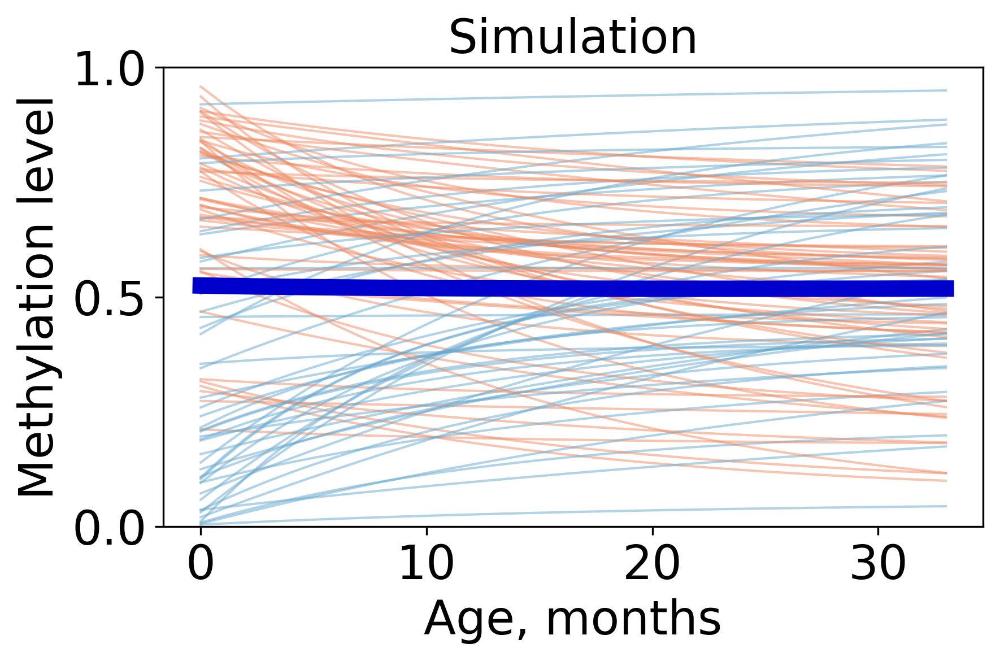

In [70]:
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
# plt.style.use('meth.mplstyle')

plt.figure(dpi=300)
def prob_closed_form(p1,p2,q,i): return p2/(p1+p2) + (q-p2/(p1+p2))*((1-p1-p2)**i)
def prob_contin_form(p1,p2,q,i, dt=1.): return p2/(p1+p2) + (q-p2/(p1+p2))*(np.exp(-(p1+p2)*(i/dt)))


def get_random(reps, scale=0.002):
    p1 = scale*np.random.uniform()
    p2 = scale*np.random.uniform()
    q = np.random.uniform()
    # if q < 0.5: color = 'red'
    # else: color = 'blue'    
    if q < p2/(p1+p2): color = color_up#'red'
    else: color = color_down#'blue'
    # return prob_closed_form(p1,p2,q,np.arange(reps)+1), color
    return prob_contin_form(p1,p2,q,np.arange(reps)+1), color

random = [get_random(1000) for i in range(100)]

for rand in random:
    plt.plot(rand[0][::30], color=rand[1], linewidth=1, alpha=0.5)
idx_red = np.array([rand[1] == 'red' for rand in random])
x = np.array([rand[0][::30] for rand in random])
print(x.shape, idx_red.shape)
plt.plot(np.mean(x[idx_red], axis=0), color='firebrick', lw=7)
plt.plot(np.mean(x[~idx_red], axis=0), color='mediumblue', lw=7)
plt.ylim((0,1))
plt.yticks([0, 0.5, 1])
plt.xticks([0, 10, 20, 30])
plt.xlabel('Age, months')
plt.ylabel('Methylation level')
plt.title('Simulation')
plt.tight_layout()
plt.savefig('PICS/Thomas_modelling.png', dpi=300)
plt.plot();

In [71]:
dsets['Mice_C57BL6']

AnnData object with n_obs × n_vars = 1976056 × 141
    obs: 'mask_nonzero', 'r_age', 'p_age', 'entropic_BA_b', 'entropic_BA_x0', 'entropic_down_BA_b', 'entropic_down_BA_x0', 'entropic_up_BA_b', 'entropic_up_BA_x0', 'antientropic_down_BA_b', 'antientropic_down_BA_x0', 'antientropic_up_BA_b', 'antientropic_up_BA_x0', 'antientropic_BA_b', 'antientropic_BA_x0', 'constant_BA_b', 'constant_BA_x0', 'insignificant_BA_b', 'insignificant_BA_x0', 'antient_insignificant_BA_b', 'antient_insignificant_BA_x0', 'antient_insignificant_up_BA_b', 'antient_insignificant_up_BA_x0', 'antient_insignificant_down_BA_b', 'antient_insignificant_down_BA_x0', 'ent_insignificant_up_BA_b', 'ent_insignificant_up_BA_x0', 'ent_insignificant_down_BA_b', 'ent_insignificant_down_BA_x0', 'ent_insignificant_BA_b', 'ent_insignificant_BA_x0', 'petkovich_clock'
    var: 'Sample Name', 'Strain/Condition', 'Age', 'Sex', 'Prepared for Sequencing ', 'Used in Subset 1/2', 'Data Type', 'Age_bin', 'Age_bin_rough', 'entropic_BA', 'ent

# Fig. 2d

(90,)
(90, 34) (90,)
(37, 16) (16,)


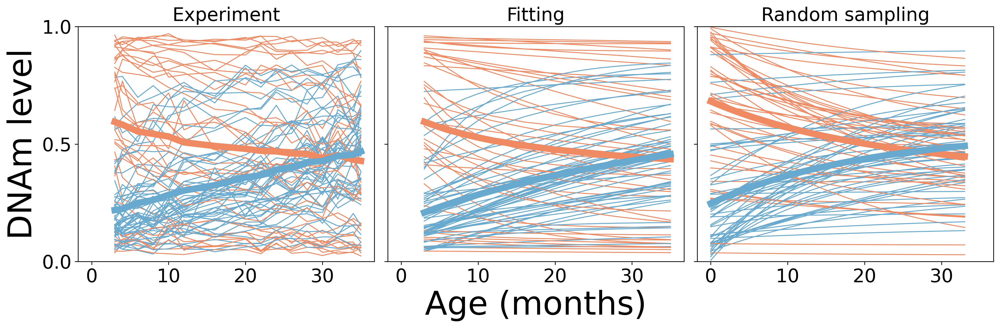

In [72]:
idx = np.nonzero(dsets['Mice_C57BL6'].obs['petkovich_clock'].abs().values > 1e-4)[0]
print(idx.shape)
un_xs_pos = []
un_xs_neg = []
un_xs_pos_pred = []
un_xs_neg_pred = []

t_ = dsets['Mice_C57BL6'].var['Age'].values * 12.
un_t = np.unique(t_)

def exp_decay(i, p1,p2,q):
    return prob_contin_form(p1,p2,q,i)

fig, ax = plt.subplots(1,3, figsize=(5*3,5),dpi=300, sharex=True, sharey=True)

np.random.seed(70)

random = [get_random(1000, scale=0.0015) for i in range(90)]
# random = [get_random_poisson(1000, scale=0.002) for i in range(100)]

pms = []
pds = []
qs = []
for i in idx:
    x_ = dsets['Mice_C57BL6'].X[i,:]
    idx_sort_ = np.argsort(t_)
    un_x = [np.nanmean(x_[t_ == u]) for u in un_t]
    # plt.plot(t_[idx_sort_], x_[idx_sort_])
    popt, pcov = curve_fit(exp_decay, un_t, un_x, p0=(0.02, 0.02, 0.25), bounds=(([1e-5, 1e-5, 0], [0.1,0.1,1.])))
    pm, pd, q = popt[0], popt[1], popt[2]
    un_x_pred = exp_decay(un_t, popt[0], popt[1], popt[2])
    pms.append(pm)
    pds.append(pd)
    qs.append(q)
    
    # if un_x[0] <= 0.5:
    if q <= pd / (pm+pd):
        col = color_up
        un_xs_pos.append(un_x)
        un_xs_pos_pred.append(un_x_pred)
    else:
        col = color_down
        un_xs_neg.append(un_x)
        un_xs_neg_pred.append(un_x_pred)
    ax[0].plot(un_t, un_x, color=col, lw=1)
    ax[1].plot(un_t, un_x_pred, color=col, #linestyle='dashed',
               lw=1)
    
pds = np.array(pds)
pms = np.array(pms)
qs = np.array(qs)

for rand in random:
    ax[2].plot(rand[0][::30], color=rand[1], linewidth=1, alpha=1.)
idx_red = np.array([rand[1] == color_up for rand in random])
# idx_red = np.array([rand[1] == 'red' for rand in random])
x = np.array([rand[0][::30] for rand in random])
print(x.shape, idx_red.shape)
ax[2].plot(np.mean(x[~idx_red], axis=0), color=color_down, lw=7)
ax[2].plot(np.mean(x[idx_red], axis=0), color=color_up, lw=7)

un_xs_neg = np.array(un_xs_neg)
un_xs_pos = np.array(un_xs_pos)
un_xs_neg_pred = np.array(un_xs_neg_pred)
un_xs_pos_pred = np.array(un_xs_pos_pred)
print(un_xs_neg.shape, un_t.shape)
ax[0].plot(un_t, np.nanmean(un_xs_neg, axis=0), color=color_down, lw=7)
ax[0].plot(un_t, np.nanmean(un_xs_pos, axis=0), color=color_up, lw=7)
ax[1].plot(un_t, np.nanmean(un_xs_neg_pred, axis=0), color=color_down, lw=7)
ax[1].plot(un_t, np.nanmean(un_xs_pos_pred, axis=0), color=color_up, lw=7)
[ax[i].set_ylim((0,1)) for i in range(3)]
[ax[i].set_xticks([0, 10, 20, 30]) for i in range(3)]
[ax[i].set_yticks([0, 0.5, 1]) for i in range(3)]
plt.tight_layout()
# [ax[i].set_xlabel('Age (months)') for i in range(3)]
ax[1].set_xlabel('Age (months)', fontsize=35)
[ax[i].set_ylabel('DNAm level', fontsize=35) for i in range(1)]
[ax[0].set_title('Experiment')]
[ax[1].set_title('Fitting')]
[ax[2].set_title('Random sampling')]
plt.tight_layout()
plt.savefig('PICS/png/Petkovich_clock_CpGs.png', dpi=300)
plt.plot();

In [73]:
dsets['Mice_C57BL6'].X.shape
dsets['Mice_C57BL6'].obs['p_age'] < 0.05

index
chr10_100015516     True
chr10_100015517    False
chr10_100015540     True
chr10_100015541    False
chr10_100015553     True
                   ...  
chrY_998589         True
chrY_998593        False
chrY_998594         True
chrY_998603        False
chrY_998604         True
Name: p_age, Length: 1976056, dtype: bool

In [74]:
# idx = np.nonzero(dsets['Mice_C57BL6'].obs['petkovich_clock'].abs().values > 1e-4)[0]
idx = np.nonzero(dsets['Mice_C57BL6'].obs['p_age'].values < 0.05)[0]

# idx = np.arange(dsets['Mice_C57BL6'].X.shape[0])
print(idx.shape)

t_ = dsets['Mice_C57BL6'].var['Age'].values * 12.
un_t = np.unique(t_)

def exp_decay(i, p1,p2,q):
    return prob_contin_form(p1,p2,q,i)

pms = []
pds = []
qs = []
for ix in trange(idx.shape[0]):
    i = idx[ix]
    x_ = dsets['Mice_C57BL6'].X[i,:]
    idx_sort_ = np.argsort(t_)
    un_x = [np.nanmean(x_[t_ == u]) for u in un_t]
    # plt.plot(t_[idx_sort_], x_[idx_sort_])
    un_x = np.array(un_x)
    idx_nonan = ~np.isnan(un_x)
    try:
        popt, pcov = curve_fit(exp_decay, un_t[idx_nonan], un_x[idx_nonan], p0=(0.02, 0.02, 0.25), bounds=(([1e-5, 1e-5, 0], [0.1,0.1,1.])))
        pm, pd, q = popt[0], popt[1], popt[2]
    except:
        pm, pd, q = -1., -1., -1.
    # un_x_pred = exp_decay(un_t, popt[0], popt[1], popt[2])
    pms.append(pm)
    pds.append(pd)
    qs.append(q)
    
pds = np.array(pds)
pms = np.array(pms)
qs = np.array(qs)

In [75]:
# np.savez('dump/Petkovich_fits_stochastic.npz', pds=pds, pms=pms, qs=qs)

# np.savez('dump/Petkovich_fits_stochastic_full_list.npz', pds=pds, pms=pms, qs=qs)

In [76]:
# dat = np.load('dump/Petkovich_fits_stochastic.npz')
dat = np.load('dump/Petkovich_fits_stochastic_full_list.npz')

pds = dat['pds']
pms = dat['pms']
qs = dat['qs']

# Fig. 2c

0.045


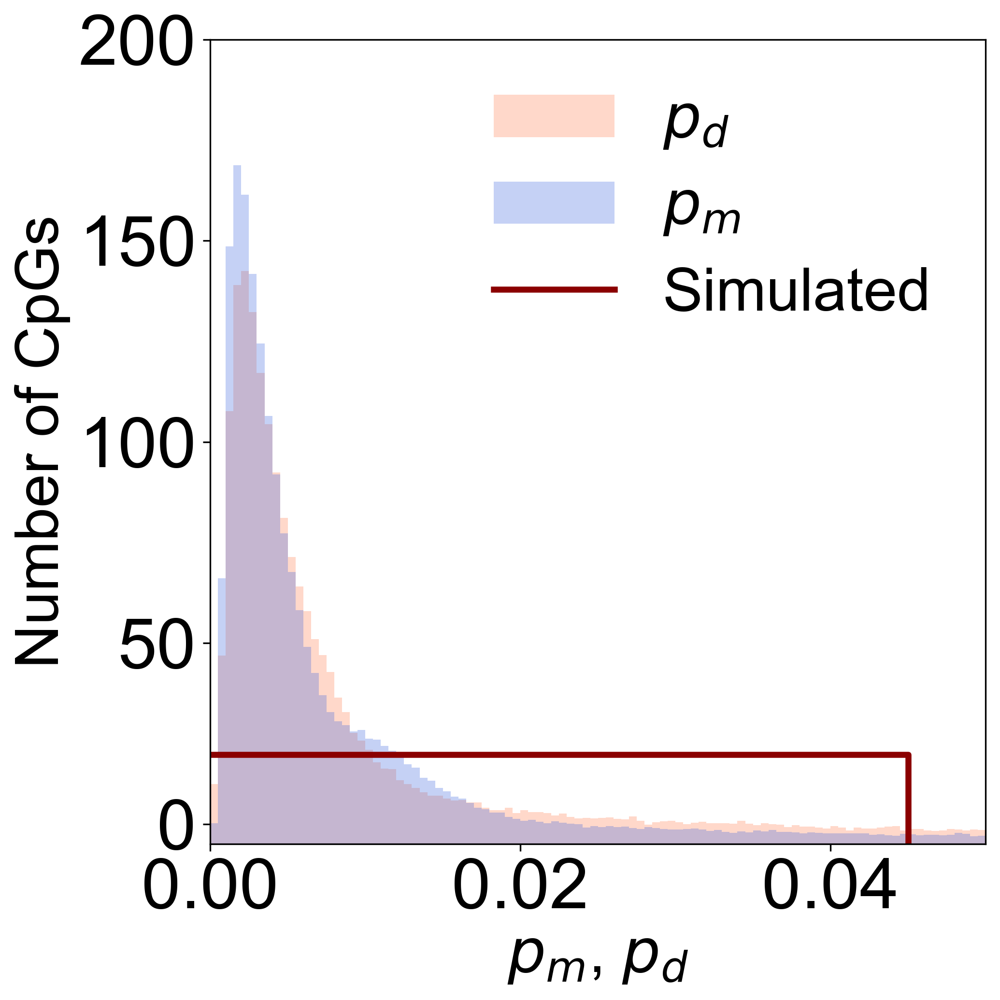

0.010939620742799845 0.013850449710477717 0.02479007045327756


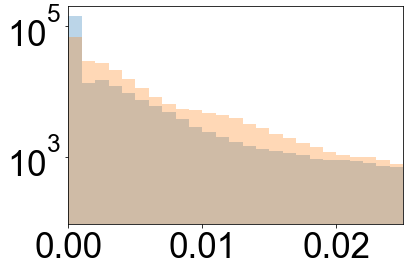

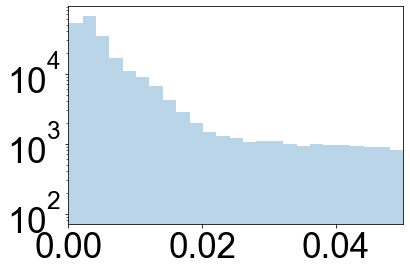

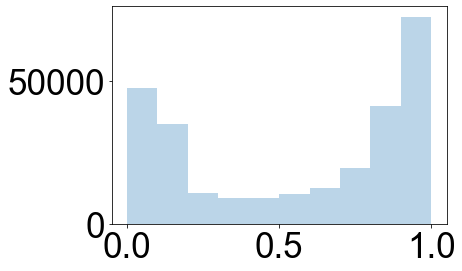

In [78]:
plt.style.use('../scDNAm/meth.mplstyle')
# plt.style.use('../Stochastic aging/pics/meth.mplstyle')

threshold = 0.0015 * 30
print(threshold)
plt.figure(figsize=(7,7), dpi=300)
# plt.hist(pms+pds, alpha=0.3, bins=100, range=(0, 0.05), density=True)
plt.hist(pds[pds > 1e-4], alpha=0.3, bins=100, range=(0, 0.05), density=True, color='coral', label=r'$p_d$')
plt.hist(pms[pms > 1e-4], alpha=0.3, bins=100, range=(0, 0.05), density=True, color='royalblue', label=r'$p_m$')

# plt.hist(pds, alpha=0.3, bins=300, range=(0, 0.1), density=False, color='coral', label=r'$p_d$')
# plt.hist(pms, alpha=0.3, bins=300, range=(0, 0.1), density=False, color='royalblue', label=r'$p_m$')

plt.plot([0, threshold, threshold],[1./threshold, 1./threshold, 0], color='darkred', label='Simulated', alpha=1.)
# plt.hist(ix, alpha=0.3, bins=100, range=(0, 0.05), density=True, color='darkred', label='Simulated', histtype='step', lw=3)
plt.xlim([0.00, 0.05])
plt.ylim([0, 200])
plt.yticks(ticks=[5,50,100,150,200], labels=[0, 50, 100, 150, 200])
plt.legend(frameon=False)
# plt.ylim([0, 190])

# plt.yscale('log')
# plt.title('185 CpGs with optimal lambda')
plt.xlabel(r'$p_m$, $p_d$')
plt.ylabel('Number of CpGs')
plt.tight_layout()
plt.savefig('../scDNAm/PICS/png/Pm_Ps_sum_hist.png', dpi=300, format='png')
plt.show()

print(np.mean(pds), np.mean(pms), np.mean(pms + pds))
plt.hist(pds, alpha=0.3, bins=100)
plt.hist(pms, alpha=0.3, bins=100)
plt.xlim([0, 0.025])
plt.yscale('log')
# plt.yscale('log')
plt.show()
plt.hist(pms+pds, alpha=0.3, bins=100)
plt.xlim([0, 0.05])
plt.yscale('log')
# plt.yscale('log')
plt.show()
plt.hist(qs, alpha=0.3)
# plt.xlim([0,1])
plt.show()

# Fig. 2b

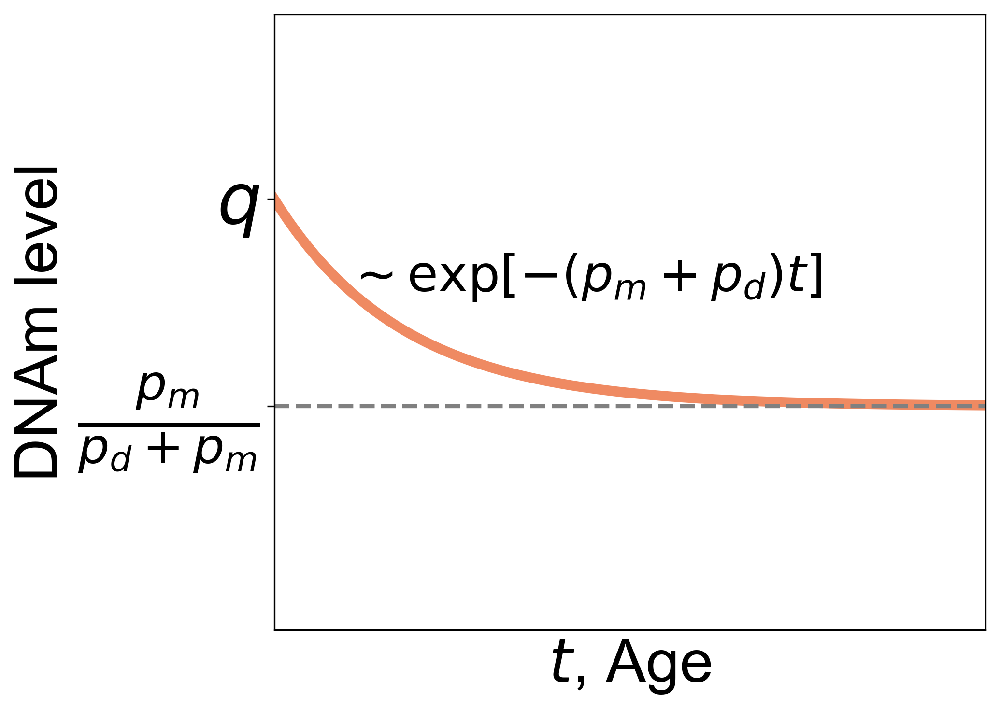

In [79]:
from matplotlib import rcParams
colors7 = np.array(['#b2182b',
'#ef8a62',
'#fddbc7',
'#c7c7c7',#'#f7f7f7',
                    
'#d1e5f0',
'#67a9cf',
'#2166ac'])
colors = colors7[np.array([2,0,1,4,-1,-2,3])]

# rcParams['axes.linewidth'] = 1 # set the value globally

plt.figure(dpi=300, figsize=(7,5))
t_ = np.linspace(0, 5, num=100)
y_ = exp_decay(t_,0.7,0.4,0.7)
p1 = 0.7
p2 = 0.4
q = 0.7
qfin = p2/(p1+p2)
lw = 5
#1
plt.plot(t_, y_, color=colors7[1],#'navy',
         lw=lw,label=1)
plt.plot([0,5],[qfin,qfin], lw=2, linestyle='dashed', color='gray')
plt.xlim([0,5])
plt.xlabel(r'$t$, Age')

# colors = ['navy', 'lime', 'forestgreen', 'blue', 'red', 'pink', 'darkred']
colors = colors7[np.array([2,0,1,4,-1,-2,3])]
numbers = [4,5,7,6,1,2,7,3,4]

# l = plt.legend(fontsize=25, loc='lower right',frameon=False)
# for i, text in enumerate(l.get_texts()):
#     text.set_color(colors[i])
plt.yticks(ticks=[q,qfin], labels=[r'$q$', r'$\frac{p_m}{p_d + p_m}$'])
plt.text(0.5,0.55, r'$\sim \exp[-(p_m + p_d)t]$', fontdict={'fontsize':25})
plt.xticks([])
plt.ylabel('DNAm level')
# plt.yticks([0, 0.5, 1])
plt.ylim([0,1])
plt.tight_layout()
plt.savefig("PICS/jpg/three_params_model.jpg", format="jpg", dpi=300)
plt.savefig("PICS/pdf/three_params_model.pdf", format="pdf", dpi=300)
plt.savefig("PICS/png/three_params_model.png", format="png", dpi=300)
plt.show()

In [81]:
idx = np.nonzero(dsets['Mice_C57BL6'].obs['p_age'].values < 0.05)[0]
print(idx)
print(dsets['Mice_C57BL6'].obs.shape)
pds.shape

[      0       2       4 ... 1976051 1976053 1976055]
(1976056, 32)


(268044,)

In [82]:
# fit_stats['ksi_X'][:,0].shape

In [83]:
# dsets[key_full].X
x0 = np.nanmean(dsets[key_full].X[:,dsets[key_full].var['Age'].values < 0.5], axis=1)
# key_full

/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_56428/3353274243.py:2: RuntimeWarning: Mean of empty slice
  x0 = np.nanmean(dsets[key_full].X[:,dsets[key_full].var['Age'].values < 0.5], axis=1)


In [84]:
tmp = np.zeros(dsets['Mice_C57BL6'].obs.shape[0]) +np.nan
tmp[idx] = pds
dsets['Mice_C57BL6'].obs['pd'] = tmp

tmp = np.zeros(dsets['Mice_C57BL6'].obs.shape[0]) +np.nan
tmp[idx] = pms
dsets['Mice_C57BL6'].obs['pm'] = tmp

tmp = np.zeros(dsets['Mice_C57BL6'].obs.shape[0]) +np.nan
tmp[idx] = qs
dsets['Mice_C57BL6'].obs['q'] = tmp


In [85]:
dsets['Mice_C57BL6'].obs['x0'] = x0

In [86]:
# dsets['Mice_C57BL6'].obs.to_csv('dump/Petkovich_stochastic_models.csv')
dsets['Mice_C57BL6'].obs.to_csv('dump/Petkovich_stochastic_models_full_list.csv')

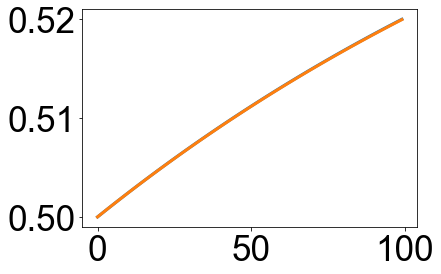

In [91]:
def prob_closed_form(p1,p2,q,i): return p2/(p1+p2) + (q-p2/(p1+p2))*((1-p1-p2)**i)
def prob_contin_form(p1,p2,q,i, dt=1.): return p2/(p1+p2) + (q-p2/(p1+p2))*(np.exp(-(p1+p2)*(i/dt)))

p1 = 0.002
p2 = 0.0025
q = 0.5
ix = np.arange(100)
plt.plot(ix,prob_closed_form(p1,p2,q,ix))
plt.plot(ix,prob_contin_form(p1,p2,q,ix))
plt.show()

In [92]:
 dsets['Mice_C57BL6'].var

,Sample Name,Strain/Condition,Age,Sex,Prepared for Sequencing,Used in Subset 1/2,Data Type,Age_bin,Age_bin_rough,entropic_BA,...,antientropic_BA,constant_BA,insignificant_BA,antient_insignificant_BA,antient_insignificant_up_BA,antient_insignificant_down_BA,ent_insignificant_up_BA,ent_insignificant_down_BA,ent_insignificant_BA,petkovich
M3204_percentage,M3204,C57BL/6,2.666016,Male,D.A. Petkovich,1.0,percentage,"(2.537, 2.918]","(2.028, 2.918]",59598.305137,...,15708.868540,-4.944581e+07,6.341583e+05,142870.666790,33853.753274,109016.913516,138825.939835,345630.911211,484456.851047,0.395894
M3503R_percentage,M3503R,C57BL/6,2.916016,Male,D.A. Petkovich,2.0,percentage,"(2.537, 2.918]","(2.028, 2.918]",77561.933928,...,18600.417461,1.863236e+07,1.114159e+06,230808.649416,63371.627559,167437.021857,232002.814014,734204.239594,966207.053608,0.692469
M2402_percentage,M2402,C57BL/6,2.000000,Male,D.A. Petkovich,2.0,percentage,"(1.774, 2.155]","(1.138, 2.028]",31939.676933,...,9410.157841,-8.409326e+05,3.099091e+05,75016.016764,32871.269185,42144.747579,95311.215574,146505.051736,241816.267310,0.205508
M0806_percentage,M0806,C57BL/6,0.666504,Male,D.A. Petkovich,1.0,percentage,"(0.629, 1.011]","(0.247, 1.138]",13478.893050,...,3482.700953,5.701864e+06,1.931485e+05,38653.437238,15502.319454,23151.117784,46615.044709,124483.306067,171098.350776,-0.067691
M3405_percentage,M3405,C57BL/6,2.833984,Male,D.A. Petkovich,2.0,percentage,"(2.537, 2.918]","(2.028, 2.918]",46904.575722,...,15073.789340,4.489174e+06,5.710555e+05,151916.404233,52238.246650,99678.157583,138333.427841,312521.812612,450855.240452,0.454184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
M10_7507_percentage,M10_7507,C57BL/6,0.833496,Male,D.A. Petkovich,2.0,percentage,"(0.629, 1.011]","(0.247, 1.138]",15971.708881,...,4656.246885,-4.391738e+06,1.651470e+05,26664.005493,19618.187095,7045.818398,65869.322023,100272.131988,166141.454011,-0.172449
M0404_percentage,M0404,C57BL/6,0.333252,Male,D.A. Petkovich,2.0,percentage,"(0.247, 0.629]","(0.247, 1.138]",4423.900490,...,1584.839953,-9.241982e+06,6.239308e+04,31986.597752,6355.476827,25631.120925,-2990.729942,1869.356595,-1121.373347,-0.558494
M2202_percentage,M2202,C57BL/6,1.833008,Male,D.A. Petkovich,1.0,percentage,"(1.774, 2.155]","(1.138, 2.028]",26668.362294,...,8266.933694,2.237912e+07,2.748918e+05,65519.793727,36045.313674,29474.480053,117528.811596,130546.611945,248075.423541,0.209616
M2804_percentage,M2804,C57BL/6,2.333984,Male,D.A. Petkovich,2.0,percentage,"(2.155, 2.537]","(2.028, 2.918]",46188.295224,...,12062.859400,3.396696e+07,6.350385e+05,152895.744051,51698.371282,101197.372769,132514.595846,349812.263579,482326.859425,0.411382


In [93]:
# idx = 
tmp = dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs.reset_index()['index'].apply(lambda x: x.split('_')[0] == 'chr7').values]
tmp = tmp[tmp.reset_index()['index'].apply(lambda x: int(x.split('_')[1]) > 7298000).values]
tmp = tmp[tmp.reset_index()['index'].apply(lambda x: int(x.split('_')[1]) < 7300000).values]
tmp#.head()
# dsets['Mice_C57BL6'].obs.reset_index()['index'].apply(lambda x: x.split('_')[0] == 'chr7').values

# dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs.reset_index()['index'].apply(lambda x: int(x.split('_')[1]) > 7299600)]
# dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs.index.isin(['chr7_7299630', 'chr7_7299640', 'chr7_7299650', 'chr7_7299660', 'chr7_7299670', 'chr7_7299680', 'chr7_7299690','chr7_7299700'])]

,mask_nonzero,r_age,p_age,entropic_BA_b,entropic_BA_x0,entropic_down_BA_b,entropic_down_BA_x0,entropic_up_BA_b,entropic_up_BA_x0,antientropic_down_BA_b,...,ent_insignificant_up_BA_x0,ent_insignificant_down_BA_b,ent_insignificant_down_BA_x0,ent_insignificant_BA_b,ent_insignificant_BA_x0,petkovich_clock,pd,pm,q,x0
index,,,,,,,,,,,,,,,,,,,,,
chr7_7298095,True,-0.070957,0.422419,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.098011
chr7_7298096,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.052092
chr7_7298107,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.032479
chr7_7298108,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.057991
chr7_7298113,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.046641
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr7_7299246,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.040000
chr7_7299262,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.067241
chr7_7299263,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.040000


In [97]:
# dsets[key_full].var[]
import pandas as pand

intx = pand.cut(df['Age'],10).values[0]
print(intx)
intx.mid

(2.616, 2.691]


2.6535

# Fig. 1b

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
petkovich
0.909215539807871 9.366155233386616e-55
3.3763860165207364


/Users/tarkhov/opt/anaconda3/envs/py310/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


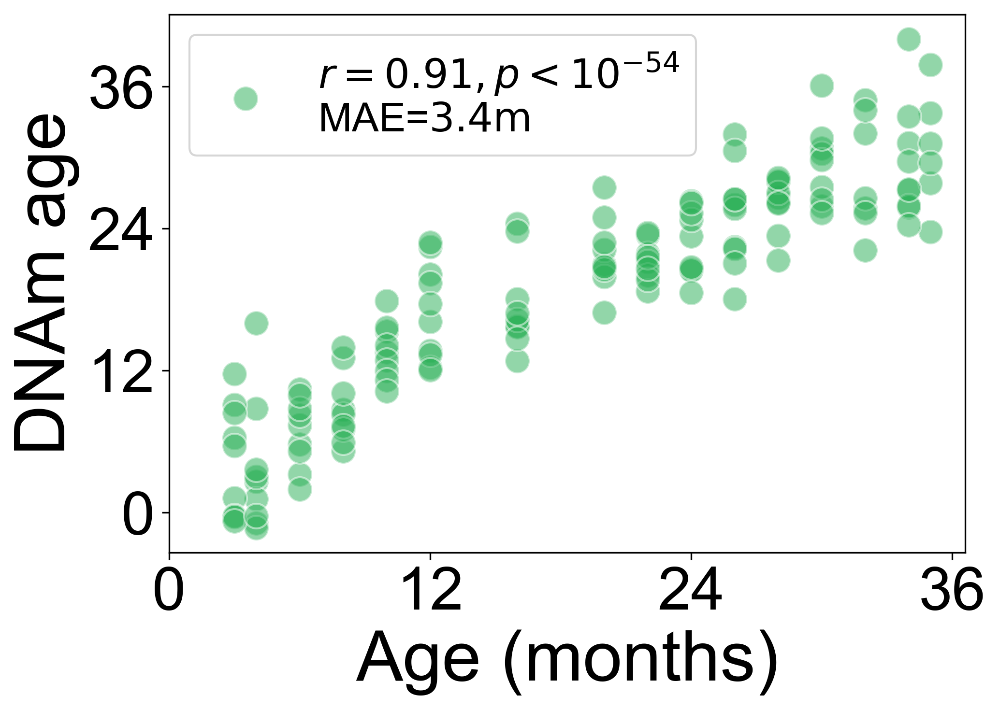

In [120]:
%load_ext autoreload
%autoreload 2
plt.style.use('../Stochastic aging/pics/meth.mplstyle')
import seaborn as sns
from scipy.stats import pearsonr
from sklearn.model_selection import LeaveOneOut
from sklearn.linear_model import ElasticNet, ElasticNetCV, LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error
# key_full = 'Mice'
key_full = 'Mice_C57BL6'
# bioage = 'petkovich'
for bioage in ["petkovich"]:# + list(bioages):
# for bioage in [list(bioages)[0]]:
    print(bioage)
    plt.figure(figsize=(7,5), dpi=300)
    for key, df in dsets[key_full].var.groupby(['Strain/Condition']):
        if key != 'C57BL/6':
            continue
        # print(pand.qcut(df['Age'], 10))
        # print(df['Age'])
        # df['Age_binned_ints'] = pand.cut(df['Age'],10)
        # df['Age_binned'] = df['Age_binned_ints'].apply(lambda x: x.mid).astype(float)#pand.cut(df['Age'],10)
        # print(df['Age_binned'])
        r,p = pearsonr(12 * df['Age'].values, df[f'{bioage}'].values)
        # sns.scatterplot(12 * df['Age'].values, df[f'{bioage}'].values, color='#27af54', s=150, alpha=0.5, label=r'$r=0.91,p <10^{-54}$')
        print(r,p)
        clf = LinearRegression()
        clf.fit(df[f'{bioage}'].values.reshape(-1,1), 12 * df['Age'].values)
        pred_ages = clf.predict(df[f'{bioage}'].values.reshape(-1,1)).flatten()
        MAE = mean_absolute_error(12 * df['Age'].values, pred_ages)
        print(MAE)
        sns.scatterplot(12 * df['Age'].values, pred_ages, color='#27af54', s=150, alpha=0.5, 
                        label=r"$r=0.91,p<10^{-54}$" + "\n" + r"MAE=$3.4\rm{m}$")
        # plt.plot(12 * df['Age'].values, pred_ages)
        # print(MAE)
        # sns.stripplot(12 * df['Age'].values, df[f'{bioage}'].values)
        # sns.boxplot((df['Age_binned'].values * 12), df[f'{bioage}'].values)
        # sns.swarmplot((df['Age_binned'].values * 12), df[f'{bioage}'].values, s=10, )
        # res = pand.merge(df.groupby(['Age']).mean(), df.groupby(['Age']).std(), on='Age')
        # plt.errorbar(12 * res.index.values, res[f"{bioage}_x"].values, res[f"{bioage}_y"].values, label=key, capsize=15)
    # plt.legend(fontsize=15, loc='upper left')
    plt.ylabel('DNAm age', fontsize=35)
    plt.xlabel("Age (months)", fontsize=35)
    plt.yticks(fontsize=30)
    plt.xticks([0, 12, 24, 36], fontsize=30)
    plt.yticks([0, 12, 24, 36], fontsize=30)
    # plt.ylim([0,0.6])
    plt.legend(loc='upper left', fontsize=20, frameon=True)
    plt.tight_layout()
    plt.savefig("pics/pdf/bioage_.pdf".format(bioage, key, binned_by), format="pdf")
    plt.savefig("pics/png/bioage_.png".format(bioage, key, binned_by), format="png")
    plt.savefig("pics/jpg/bioage_.jpg".format(bioage, key, binned_by), format="jpg")
    plt.show()

# Fig.1f (for R)

In [65]:
bioages_for_plotting = ['petkovich_clock']

df = dsets['Mice_C57BL6'].obs.copy()
df.reset_index(inplace=True)
df['chr'] = df['index'].apply(lambda x: x.split('_')[0])
df['pos_start'] = df['index'].apply(lambda x: int(x.split('_')[1]))
df['pos_end'] = df['index'].apply(lambda x: int(x.split('_')[1]) + 10)
df['col4'] = "*"
df['col5'] = 0.
df['strand'] = "*"

for i, bioage in enumerate(bioages_for_plotting):
    idx = df[f"{bioage}"].abs().values > 1e-3
    df.loc[df.index[idx], 'col4'] = bioage
df = df[df['col4'] != '*']
df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b']].to_csv(f'data/GSE80672/GSE80672_Petkovich_regions.csv', index=None, header=None, sep='\t')
    # df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b', 'entropic_BA_x0',  'antientropic_BA_b', 'antientropic_BA_x0']].to_csv(f'data/GSE80672/GSE80672_{regions[i]}_regions.csv', index=None, header=None)

In [66]:
bioages_for_plotting = ['entropic_down_BA', 'entropic_up_BA', 'antientropic_down_BA', 'antientropic_up_BA',
                        'constant_BA',  'antient_insignificant_up_BA', 'antient_insignificant_down_BA', 
                        'ent_insignificant_up_BA', 'ent_insignificant_down_BA', 'petkovich_clock']

df = dsets['Mice_C57BL6'].obs.copy()
df.reset_index(inplace=True)
df['chr'] = df['index'].apply(lambda x: x.split('_')[0])
df['pos_start'] = df['index'].apply(lambda x: int(x.split('_')[1]))
df['pos_end'] = df['index'].apply(lambda x: int(x.split('_')[1]) + 10)
df['col4'] = "*"
df['col5'] = 0.
df['strand'] = "*"

for i, bioage in enumerate(bioages_for_plotting):
    if bioage == 'petkovich_clock':
        idx = df[f"{bioage}"].abs().values > 1e-3
    else:
        idx = df[f"{bioage}_b"].abs().values > 1e-3
    df.loc[df.index[idx], 'col4'] = bioage
df = df[df['col4'] != '*']
df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b']].to_csv(f'data/GSE80672/GSE80672_regions.csv', index=None, header=None, sep='\t')
    # df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b', 'entropic_BA_x0',  'antientropic_BA_b', 'antientropic_BA_x0']].to_csv(f'data/GSE80672/GSE80672_{regions[i]}_regions.csv', index=None, header=None)

In [67]:
entropic_regions = dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs['entropic_BA_b'].abs() > 1e-6]
antientropic_regions = dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs['antientropic_BA_b'].abs() > 1e-6]

In [68]:
# entropic_regions.reset_index(inplace=True)
regions = ['entropic', 'antientropic']
for i, df in enumerate([entropic_regions, antientropic_regions]):
    df.reset_index(inplace=True)
    df['chr'] = df['index'].apply(lambda x: x.split('_')[0])
    df['pos_start'] = df['index'].apply(lambda x: int(x.split('_')[1]))
    df['pos_end'] = df['index'].apply(lambda x: int(x.split('_')[1]) + 10)
    df['col4'] = df['r_age'] > 1e-3
    df['col5'] = 0.
    df['strand'] = "*"
    df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b']].to_csv(f'data/GSE80672/GSE80672_{regions[i]}_regions.csv', index=None, header=None, sep='\t')
    # df[['chr', 'pos_start', 'pos_end', 'col4', 'col5', 'strand', 'r_age', 'p_age', 'entropic_BA_b', 'entropic_BA_x0',  'antientropic_BA_b', 'antientropic_BA_x0']].to_csv(f'data/GSE80672/GSE80672_{regions[i]}_regions.csv', index=None, header=None)

/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_13354/2668548473.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['chr'] = df['index'].apply(lambda x: x.split('_')[0])
/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_13354/2668548473.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pos_start'] = df['index'].apply(lambda x: int(x.split('_')[1]))
/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_13354/2668548473.py:7: SettingWithCopyWarning: 
A value is trying to be 

In [83]:
key_full = 'Mice_para_liver'
# key_full = 'Mice_para_blood'
# group_from = 'Young ISO'
# group_to = 'Young HET '

# group_from = 'Young ISO Det.'
# group_to = 'Young HET Det.'
group_from = 'Old ISO Det.'
group_to = 'Old HET Det.'

# group_from = 'Old HET'
# group_to = 'Old HET Det.'

# group_from = 'Old HET'
# group_to = 'Old ISO'

t = np.zeros(dsets[key_full].var.shape[0]) + np.nan
t[dsets[key_full].var['GroupLabel'] == group_from] = 0.
t[dsets[key_full].var['GroupLabel'] == group_to] = 1.
Y_tmp = anatools.logit(anatools.mask_0_1_tonan(dsets[key_full].X.astype(np.float64)))
b, x = anatools.shooting(Y_tmp, t)
r_pb, p_pb = anatools.fast_pearsonr(Y_tmp, t)
idx = np.logical_and(p_pb < 0.05, np.isfinite(r_pb))

dsets[key_full].obs[f"from {group_from} to {group_to}_b"] = 0.
dsets[key_full].obs[f"from {group_from} to {group_to}_x0"] = 0.

dsets[key_full].obs.loc[dsets[key_full].obs.index[idx], f"from {group_from} to {group_to}_b"] = b[idx]
dsets[key_full].obs.loc[dsets[key_full].obs.index[idx], f"from {group_from} to {group_to}_x0"] = x[idx]

/Users/tarkhov/Dropbox/Harvard/Science/Stochastic aging/meth/analytic_tools.py:29: RuntimeWarning: Mean of empty slice
  X_mean = np.nanmean(X, axis=1)
/Users/tarkhov/Dropbox/Harvard/Science/Stochastic aging/meth/analytic_tools.py:30: RuntimeWarning: Mean of empty slice
  t_mean = np.nanmean(t_matrix, axis=1)
/Users/tarkhov/opt/anaconda3/envs/py310/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/tarkhov/Dropbox/Harvard/Science/Stochastic aging/meth/analytic_tools.py:32: RuntimeWarning: invalid value encountered in true_divide
  b = (np.nansum(X * t_matrix, axis=1) / number_nonans - X_mean * t_mean) / (t_std ** 2)
/Users/tarkhov/Dropbox/Harvard/Science/Stochastic aging/meth/analytic_tools.py:32: RuntimeWarning: divide by zero encountered in true_divide
  b = (np.nansum(X * t_matrix, axis=1) / number_nonans - X_mean * t_mean) / (t_std ** 2)
/Users/tarkhov/D

In [ ]:
idx = np.logical_and(p_pb < 0.05, np.isfinite(r_pb))

In [87]:
dsets['Mice_C57BL6'].obs[dsets['Mice_C57BL6'].obs['entropic_down_BA_b'].abs() > 1e-6 ]

,mask_nonzero,r_age,p_age,entropic_BA_b,entropic_BA_x0,entropic_down_BA_b,entropic_down_BA_x0,entropic_up_BA_b,entropic_up_BA_x0,antientropic_down_BA_b,...,antient_insignificant_up_BA_x0,antient_insignificant_down_BA_b,antient_insignificant_down_BA_x0,ent_insignificant_up_BA_b,ent_insignificant_up_BA_x0,ent_insignificant_down_BA_b,ent_insignificant_down_BA_x0,ent_insignificant_BA_b,ent_insignificant_BA_x0,petkovich_clock
index,,,,,,,,,,,,,,,,,,,,,
chr10_100044740,True,-0.524964,2.348679e-11,-2.687513,1.734818,-2.687513,1.734818,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chr10_100725510,True,-0.434962,7.057985e-08,-6.793854,0.537034,-6.793854,0.537034,0.0,0.0,-6.793854,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chr10_100750280,True,-0.542065,4.619128e-12,-2.466147,1.664291,-2.466147,1.664291,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chr10_10246170,True,-0.537534,6.060081e-11,-2.352020,2.746063,-2.352020,2.746063,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chr10_102564160,True,-0.485686,1.030721e-09,-2.802142,2.443014,-2.802142,2.443014,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrY_90818720,True,-0.523442,2.744235e-11,-4.083517,1.625609,-4.083517,1.625609,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chrY_90818740,True,-0.525359,2.255297e-11,-5.838308,0.589921,-5.838308,0.589921,0.0,0.0,-5.838308,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
chrY_90818750,True,-0.603702,2.302744e-15,-3.176811,1.785698,-3.176811,1.785698,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Age
0.416748    0.057013
0.500000    0.091125
Name: petkovich_y, dtype: float64

In [108]:
importlib.reload(anatools)
b, x0 = anatools.shooting(fit_stats['ksi'], fit_stats['age_bins_mid'])
print(b.shape, x0.shape)

(810203,) (810203,)


In [91]:
importlib.reload(anatools)
b_X, x0_X = anatools.shooting(fit_stats['ksi_X'], fit_stats['age_bins_mid'])
print(b_X.shape, x0_X.shape)

(810203,) (810203,)


In [92]:
importlib.reload(anatools)
b_by_strain = np.zeros((len(strains), X.shape[0]))
x0_by_strain = np.zeros((len(strains), X.shape[0]))
for j, strain in enumerate(strains):
    b_by_strain[j,:], x0_by_strain[j,:] = anatools.shooting(fit_stats_by_strain['ksi'][:,j,:], fit_stats_by_strain['age_bins_mid'])
print(b_by_strain.shape, x0_by_strain.shape)

(1, 810203) (1, 810203)


In [93]:
print(key)
print("Overall CpG sites: {}".format(p.shape[0]))
print(r"CpG sites, p < 0.05: {}".format(np.sum(p < 0.05)))
print(r"CpG sites, p < 0.0005: {}".format(np.sum(p < 0.05 / 100)))
print(r"CpG sites, p < 0.05 (Bonferroni): {}".format(np.sum(p < 0.05 / p.shape[0])))

Snell Dwarf Control


IndexError: tuple index out of range

In [ ]:
# linregress(fit_stats['age_bins_mid'], fit_stats['ksi'])

In [ ]:
# # age = dsets[key].var['Age'].values
# # indices = np.nonzero(p < 0.05 / X.shape[0])[0]
# idx_young = np.nonzero(dsets[key].var['Age_bin'].values == fit_stats['age_bins'][0])[0]

# indices = np.nonzero(np.logical_and(p < 0.05 / X.shape[0], fit_stats['ksi'][:, 0] > 2))[0]
# for icg in indices[np.random.random_integers(0, indices.shape[0], 10)]:
#     plt.errorbar(fit_stats['age_bins_mid'], fit_stats['ksi'][icg, :], fit_stats['sigma'][icg, :])
#     plt.plot(fit_stats['age_bins_mid'], x0[icg] + b[icg] * fit_stats['age_bins_mid'])
#     plt.show()

In [118]:
fit_stats['age_bins'] * 12

array([Interval(2.964, 7.548, closed='right'),
       Interval(7.548, 12.131999999999998, closed='right'),
       Interval(12.131999999999998, 16.704, closed='right'),
       Interval(16.704, 21.288, closed='right'),
       Interval(21.288, 25.86, closed='right'),
       Interval(25.86, 30.444, closed='right'),
       Interval(30.444, 35.016000000000005, closed='right')], dtype=object)

# Fig. 1c Absolute change of methylation

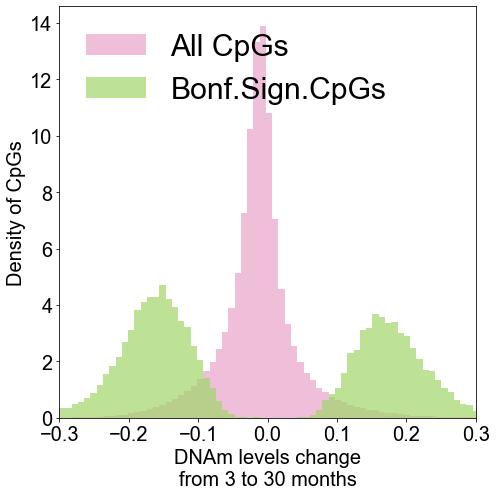

In [88]:
fig, ax = plt.subplots(1, 1, figsize=(7,7))
ax.hist(fit_stats['ksi_X'][:,-1] - fit_stats['ksi_X'][:,0], bins=100, color='#e9a3c9', density=True, alpha=0.7, label="All CpGs")
ax.hist(fit_stats['ksi_X'][isign,-1] - fit_stats['ksi_X'][isign,0], bins=100, color='#a1d76a', density=True, alpha=0.7, label="Bonf.Sign.CpGs")
ax.set_xlabel("DNAm levels change\nfrom 3 to 30 months")
ax.set_ylabel("Density of CpGs")
ax.set_xlim([-0.3,0.3])
ax.legend(loc='upper left', frameon=False)
plt.tight_layout()
plt.savefig("pics/jpg/meth_change_old_vs_you_{}.jpg".format(key), format="jpg")
plt.savefig("pics/png/meth_change_old_vs_you_{}.png".format(key), format="png", dpi=300)
plt.savefig("pics/pdf/meth_change_old_vs_you_{}.pdf".format(key), format="pdf")
plt.show()

In [110]:
colors

array(['#fddbc7', '#b2182b', '#ef8a62', '#d1e5f0', '#2166ac', '#67a9cf',
       '#c7c7c7'], dtype='<U7')

In [125]:
bioages_for_plotting = ['1', '2', '3','4','5','6','7']#'entropic_down_BA', 'entropic_up_BA', 'antientropic_down_BA', 'antientropic_up_BA',
#                        'constant_BA',  'antient_insignificant_up_BA', 'antient_insignificant_down_BA', 
 #                       'ent_insignificant_up_BA', 'ent_insignificant_down_BA', 'petkovich_clock']

df = dsets['Mice_C57BL6'].obs.copy()
df['dynamics_type'] = '*'
for i, bioage in enumerate(bioages_for_plotting):
    if bioage == '1':
        idx = df[f"p_age"].values > 0.05
        idx = np.logical_and(idx, df['x0'].values < 0.2)
    elif bioage == '2':
        idx = df[f"entropic_up_BA_b"].abs().values > 1e-3
    elif bioage == '3':
        idx = df[f"antientropic_up_BA_b"].abs().values > 1e-3
    elif bioage == '4':
        idx = df[f"p_age"].values > 0.05
        idx = np.logical_and(idx, df['x0'].values > 0.8)
    elif bioage == '5':
        idx = df[f"entropic_down_BA_b"].abs().values > 1e-3
    elif bioage == '6':
        idx = df[f"antientropic_down_BA_b"].abs().values > 1e-3
    elif bioage == '7':
        idx = df[f"p_age"].values > 0.05
        idx = np.logical_and(idx, np.logical_and(df['x0'].values > 0.4, df['x0'].values < 0.6))
    df.loc[df.index[idx], 'dynamics_type'] = bioage
df.head()

,mask_nonzero,r_age,p_age,entropic_BA_b,entropic_BA_x0,entropic_down_BA_b,entropic_down_BA_x0,entropic_up_BA_b,entropic_up_BA_x0,antientropic_down_BA_b,...,ent_insignificant_down_BA_b,ent_insignificant_down_BA_x0,ent_insignificant_BA_b,ent_insignificant_BA_x0,petkovich_clock,pd,pm,q,x0,dynamics_type
index,,,,,,,,,,,,,,,,,,,,,
chr10_100015516,True,0.247693,0.004339,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,4.450867,-2.095952,0.0,0.003840,0.00001,0.118046,0.136509,*
chr10_100015517,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.000000,0.0,NaN,NaN,NaN,0.065552,1
chr10_100015540,True,0.372971,0.000155,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,2.968078,-2.923920,0.0,0.002958,0.00001,0.055041,0.081446,*
chr10_100015541,False,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.000000,0.0,NaN,NaN,NaN,0.075994,1
chr10_100015553,True,0.202238,0.019109,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,6.117220,-2.724293,0.0,0.001219,0.00001,0.070708,0.082098,*


# Fig. 1g

/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_7094/3441311939.py:23: DeprecationWarning: This function is deprecated. Please call randint(0, 810202 + 1) instead
  idx_rand = np.random.random_integers(0, X.shape[0] - 1, num_ind)


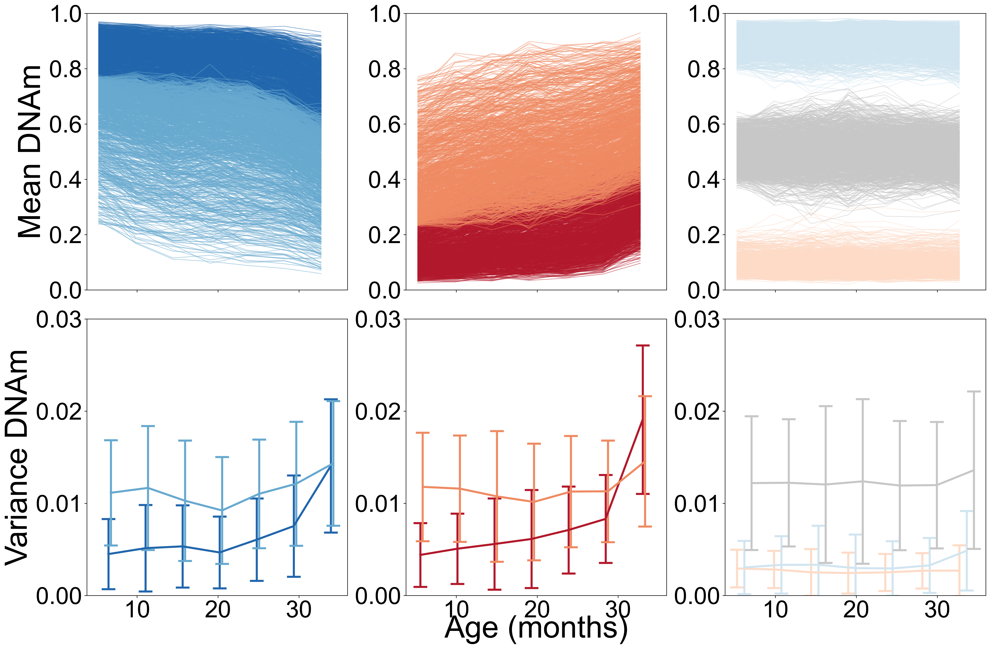

In [190]:
if key == 'NMR':
    num_ind = 1000
elif key == 'Mice_CR':
    num_ind = 1000
else:
    num_ind = 1000

# bioage = 'entropic'
bioage = 'antientropic'
fig, ax = plt.subplots(2, 3, figsize=(3 * 7,2 * 7), sharex=True, dpi=300)#, sharey=True)
fig.add_subplot(111, frameon=False)
i = 0
key = 'Mice_C57BL6'

np.random.shuffle(idx_down)
np.random.shuffle(idx_up)
idx_down = idx_down[:num_ind]
idx_up = idx_up[:num_ind]

idx_down = np.nonzero(np.abs(dsets[key].obs[dsets[key].obs['mask_nonzero']][f'{bioage}_down_BA_b'].values) > 1e-6)[0]
idx_up = np.nonzero(np.abs(dsets[key].obs[dsets[key].obs['mask_nonzero']][f'{bioage}_up_BA_b'].values) > 1e-6)[0]
num_ind = 1000
idx_rand = np.random.random_integers(0, X.shape[0] - 1, num_ind)

np.random.shuffle(idx_down)
np.random.shuffle(idx_up)
idx_down = idx_down[:num_ind]
idx_up = idx_up[:num_ind]

lw = 1
alpha = 0.5
if key == 'NMR':
    alpha = 0.01
coords = {'1': 2, 
         '2': 1,
         '3': 1,
         '4': 2,
         '5': 0,
         '6': 0,
         '7': 2}

for i, bioage in enumerate(bioages_for_plotting):
    idx_bio = np.nonzero(df[dsets[key].obs['mask_nonzero']]['dynamics_type'].values == bioage)[0][:1000]
    sigmas = np.vstack([fit_stats['sigma_X'][icg, :]**2 for icg in idx_bio])
    for icg in idx_bio:
        ax[0,coords[bioage]].plot(fit_stats['age_bins_mid'] * 12, fit_stats['ksi_X'][icg, :], color=colors[i],lw=lw, alpha=alpha)#, fit_stats['sigma'][icg, :])
        # ax[1,coords[bioage]].plot(fit_stats['age_bins_mid'] * 12, fit_stats['ksi_X'][icg, :] - x0_X[icg], color=colors[i],lw=lw, alpha=alpha)#, fit_stats['sigma'][icg, :])
    ax[1,coords[bioage]].errorbar(fit_stats['age_bins_mid'] * 12 + i * 0.3, np.nanmean(sigmas, axis=0), np.nanstd(sigmas, axis=0), color=colors[i],
                                  capsize=10, capthick=3, elinewidth=3, lw=3, alpha=1.)#, fit_stats['sigma'][icg, :])

ax[0,0].set_ylabel(r"$\log \frac{x}{1-x}$")
ax[1,0].set_ylabel(r"$\log \frac{x}{1-x}-\log\frac{x}{1-x}|_{t=0}$")
# ax[0,2].legend()
ax[0,0].set_ylabel(r"Mean DNAm",fontsize=45)
ax[1,0].set_ylabel(r"Variance DNAm",fontsize=45)
plt.tick_params(labelcolor='none', which='both', top=False, bottom=False, left=False, right=False)
plt.xlabel("Age (months)",fontsize=45)
[ax[0,i].set_ylim([0,1]) for i in range(3)]
[ax[1,i].set_ylim([0,0.03]) for i in range(3)]
[ax[i,j].tick_params(which='both', labelsize=35) for i in range(2) for j in range(3)]
# [ax[i,j].set_yticks(fontsize=35) for i in range(2) for j in range(3)]
plt.tight_layout()
plt.savefig("pics/jpg/meth_age_trajs_{}_{}.jpg".format(bioage, key), format="jpg", dpi=300)
plt.savefig("pics/png/meth_age_trajs_{}_{}.jpg".format(bioage, key), format="jpg", dpi=300)
plt.savefig("pics/pdf/meth_age_trajs_{}_{}.pdf".format(bioage, key), format="pdf", dpi=300)
plt.show()

# Fig. 1h

/var/folders/v_/gtsrj3xs0_131ltxwg51r_f40000gn/T/ipykernel_7094/3893653800.py:23: DeprecationWarning: This function is deprecated. Please call randint(0, 810202 + 1) instead
  idx_rand = np.random.random_integers(0, X.shape[0] - 1, num_ind)


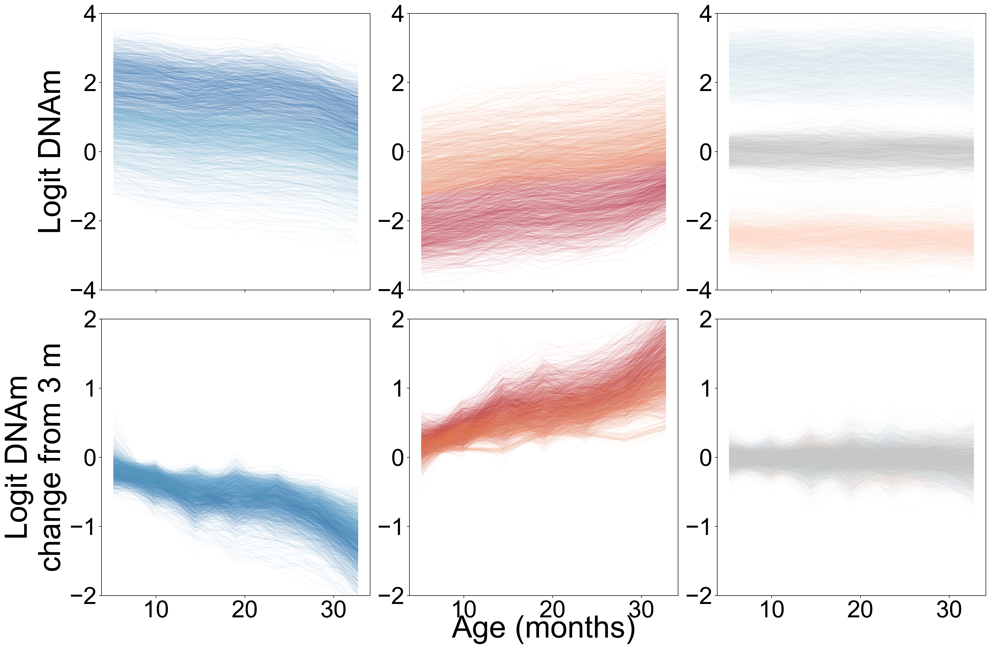

In [191]:
if key == 'NMR':
    num_ind = 1000
elif key == 'Mice_CR':
    num_ind = 1000
else:
    num_ind = 1000

# bioage = 'entropic'
bioage = 'antientropic'
fig, ax = plt.subplots(2, 3, figsize=(3 * 7,2 * 7), sharex=True, dpi=300)#, sharey=True)
fig.add_subplot(111, frameon=False)
i = 0
key = 'Mice_C57BL6'

np.random.shuffle(idx_down)
np.random.shuffle(idx_up)
idx_down = idx_down[:num_ind]
idx_up = idx_up[:num_ind]

idx_down = np.nonzero(np.abs(dsets[key].obs[dsets[key].obs['mask_nonzero']][f'{bioage}_down_BA_b'].values) > 1e-6)[0]
idx_up = np.nonzero(np.abs(dsets[key].obs[dsets[key].obs['mask_nonzero']][f'{bioage}_up_BA_b'].values) > 1e-6)[0]
num_ind = 1000
idx_rand = np.random.random_integers(0, X.shape[0] - 1, num_ind)

np.random.shuffle(idx_down)
np.random.shuffle(idx_up)
idx_down = idx_down[:num_ind]
idx_up = idx_up[:num_ind]

lw = 1
alpha = 0.05
if key == 'NMR':
    alpha = 0.01
coords = {'1': 2, 
         '2': 1,
         '3': 1,
         '4': 2,
         '5': 0,
         '6': 0,
         '7': 2}

for i, bioage in enumerate(bioages_for_plotting):
    idx_bio = np.nonzero(df[dsets[key].obs['mask_nonzero']]['dynamics_type'].values == bioage)[0][:1000]
    for icg in idx_bio:
        ax[0,coords[bioage]].plot(fit_stats['age_bins_mid'] * 12, fit_stats['ksi'][icg, :], color=colors[i],lw=lw, alpha=alpha)#, fit_stats['sigma'][icg, :])
        ax[1,coords[bioage]].plot(fit_stats['age_bins_mid'] * 12, fit_stats['ksi'][icg, :] - x0[icg], color=colors[i],lw=lw, alpha=alpha)#, fit_stats['sigma'][icg, :])
ax[0,0].set_ylabel(r"Logit DNAm",fontsize=45)
ax[1,0].set_ylabel("Logit DNAm\nchange from 3 m",fontsize=45)
plt.tick_params(labelcolor='none', which='both', top=False, bottom=False, left=False, right=False)
plt.xlabel("Age (months)",fontsize=45)
[ax[0,i].set_ylim([-4,4]) for i in range(3)]
[ax[1,i].set_ylim([-2,2]) for i in range(3)]
[ax[i,j].tick_params(which='both', labelsize=35) for i in range(2) for j in range(3)]
# [ax[i,j].set_yticks(fontsize=35) for i in range(2) for j in range(3)]
plt.tight_layout()
plt.savefig("pics/jpg/meth_age_trajs_logit_{}_{}.jpg".format(bioage, key), format="jpg", dpi=300)
plt.savefig("pics/png/meth_age_trajs_logit_{}_{}.jpg".format(bioage, key), format="jpg", dpi=300)
plt.savefig("pics/pdf/meth_age_trajs_logit_{}_{}.pdf".format(bioage, key), format="pdf", dpi=300)
plt.show()